___
# Loading the data and libraries
___

In [1]:
%load_ext autoreload
%autoreload 2

import os
import sys
import warnings

while any(marker in os.getcwd() for marker in ['workspace_p2']):
    os.chdir("..")

sys.path.append('classes_and_functions_p2')

current_directory = os.getcwd()
current_directory

'c:\\Users\\barto\\Documents\\Kody\\MachineLearning\\Project2'

In [2]:
# Importing external packages
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats
import itertools
import statsmodels.api as sm
import random
import umap.umap_ as umap
from sklearn.cluster import DBSCAN
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import FunctionTransformer
from statsmodels.formula.api import ols
from imblearn.combine import SMOTEENN
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.decomposition import PCA
from sklearn.manifold import Isomap, TSNE
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram, linkage

# Importing custom-made functions and classes
from classes_and_functions_p2.custom_functions_classes_p2 import (
    DropColumnTransformer,
    LogTransformer,
    corr_matrix_dataframe,
    plot_algo3d,
    plot_algo3d_interactive,
    plot_violin_with_binary_hue,
    evaluate_kmeans_clustering,
)

import warnings
warnings.filterwarnings("ignore")

c:\Users\barto\anaconda3\envs\mda\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
raw_orders = pd.read_csv('attachments_p2/orders_dataset.csv')
raw_products = pd.read_csv('attachments_p2/products_dataset.csv')
raw_order_reviews = pd.read_csv('attachments_p2/order_reviews_dataset.csv')
raw_order_items = pd.read_csv('attachments_p2/order_items_dataset.csv')

In [5]:
raw_orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [6]:
raw_order_reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


In [10]:
raw_products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [29]:
raw_order_items.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [30]:
print(
    raw_orders.shape,
    raw_order_reviews.shape,
    raw_products.shape,
    raw_order_items.shape,
)

(99441, 8) (99224, 7) (32951, 9) (112650, 7)


---
# ***EDA***
---

## Order Reviews Analysis

In [4]:
raw_order_reviews

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53
...,...,...,...,...,...,...,...
99219,574ed12dd733e5fa530cfd4bbf39d7c9,2a8c23fee101d4d5662fa670396eb8da,5,NaN,NaN,2018-07-07 00:00:00,2018-07-14 17:18:30
99220,f3897127253a9592a73be9bdfdf4ed7a,22ec9f0669f784db00fa86d035cf8602,5,NaN,NaN,2017-12-09 00:00:00,2017-12-11 20:06:42
99221,b3de70c89b1510c4cd3d0649fd302472,55d4004744368f5571d1f590031933e4,5,NaN,"Excelente mochila, entrega super rápida. Super...",2018-03-22 00:00:00,2018-03-23 09:10:43
99222,1adeb9d84d72fe4e337617733eb85149,7725825d039fc1f0ceb7635e3f7d9206,4,NaN,NaN,2018-07-01 00:00:00,2018-07-02 12:59:13


<Axes: xlabel='review_score', ylabel='count'>

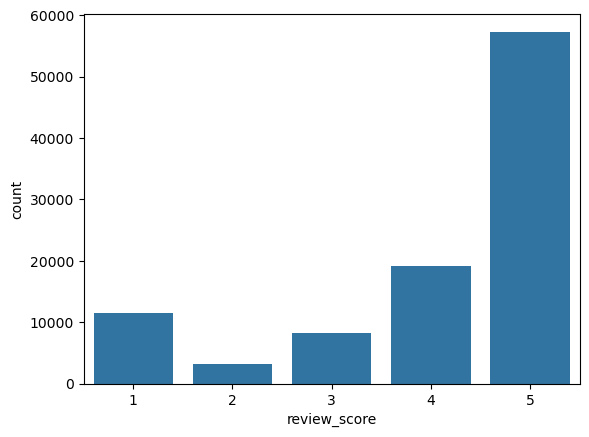

In [5]:
sns.countplot(raw_order_reviews, x = 'review_score')

<Axes: xlabel='review_score', ylabel='count'>

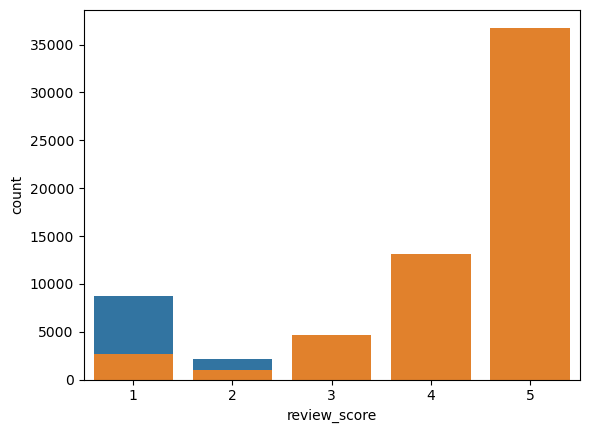

In [27]:
raw_order_reviews_comment = raw_order_reviews[~raw_order_reviews['review_comment_message'].isna()]
raw_order_reviews_no_comment = raw_order_reviews[raw_order_reviews['review_comment_message'].isna()]
sns.countplot(raw_order_reviews_comment, x='review_score')
sns.countplot(raw_order_reviews_no_comment, x='review_score')

 - Orange - people with no comments
 - Blue - people with comments

It seems that people with that were not satified are not likely to give any reviews. 

## Product qualtity for customers

In [4]:
raw_products

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0
...,...,...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,45.0,67.0,2.0,12300.0,40.0,40.0,40.0
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,41.0,971.0,1.0,1700.0,16.0,19.0,16.0
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,50.0,799.0,1.0,1400.0,27.0,7.0,27.0
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,60.0,156.0,2.0,700.0,31.0,13.0,20.0


In [4]:
raw_products_without_nulls = raw_products.dropna()
raw_products_without_nulls

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0
...,...,...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,45.0,67.0,2.0,12300.0,40.0,40.0,40.0
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,41.0,971.0,1.0,1700.0,16.0,19.0,16.0
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,50.0,799.0,1.0,1400.0,27.0,7.0,27.0
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,60.0,156.0,2.0,700.0,31.0,13.0,20.0


In [5]:
raw_products_without_nulls.isnull().sum()

product_id                    0
product_category_name         0
product_name_lenght           0
product_description_lenght    0
product_photos_qty            0
product_weight_g              0
product_length_cm             0
product_height_cm             0
product_width_cm              0
dtype: int64

In [37]:
random_product_id = raw_products.iloc[500, 0]
raw_order_items[raw_order_items['product_id'] == random_product_id]

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
15044,224a2924f75dd381b65e75fa1e9b98d4,1,2ae501b303a5a8e6f75c8c36f366b2d5,4e06067cc08b3f41d837768d392c3ee3,2017-12-07 04:39:00,19.99,14.10
50355,72705672ab6238e6354d9889c34ec409,1,2ae501b303a5a8e6f75c8c36f366b2d5,4e06067cc08b3f41d837768d392c3ee3,2018-07-11 02:51:03,19.99,7.79
55969,7f4988e3479541a14ffd638419c902b1,1,2ae501b303a5a8e6f75c8c36f366b2d5,4e06067cc08b3f41d837768d392c3ee3,2017-07-20 15:43:23,19.99,12.48
110699,fb8705064d6146e5fdc372b0fc2bf60a,2,2ae501b303a5a8e6f75c8c36f366b2d5,4e06067cc08b3f41d837768d392c3ee3,2018-05-08 22:30:42,19.99,19.04


---
# ***Dimensionality Reduction***
---

In [5]:
pca = PCA(n_components=3)
pca_data = pca.fit_transform(raw_products_without_nulls.iloc[:, 2:])

In [18]:
umapik = umap.UMAP(n_components=3)
umap_data = umapik.fit_transform(raw_products_without_nulls.iloc[:, 2:])

### PCA with KMeans

In [7]:
from sklearn.cluster import KMeans
import pandas as pd

optimal_clusters = 20

kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(pca_data)
    
target_series = pd.Series(cluster_labels)

plot_algo3d_interactive(pca_data, target_series, algo_name='UMAP', target_name='Clusters', dot_size=2)

  File "c:\Users\barto\anaconda3\envs\mda\lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


## Clusterer $\implies$ ***UMAP***

The highest silhouette score: 0.8299992832576638 (Optimal clusters: 2)
The lowest Davies-Bouldin score: 0.45841181217367666 (Optimal clusters: 2)
The highest Calinski-Harabasz score: 146232.5526024649 (Optimal clusters: 22)


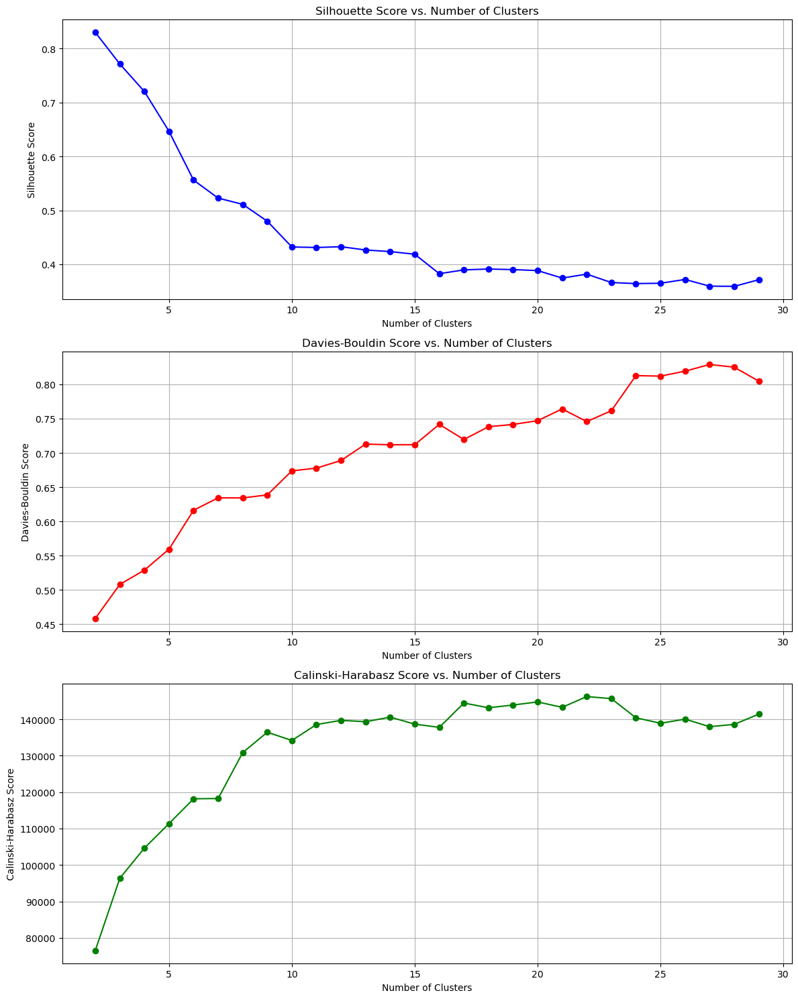

{'silhouette': {'max_score': 0.8299992832576638, 'optimal_clusters': 2},
 'davies_bouldin': {'min_score': 0.45841181217367666, 'optimal_clusters': 2},
 'calinski_harabasz': {'max_score': 146232.5526024649, 'optimal_clusters': 22}}

In [22]:
evaluate_kmeans_clustering(raw_products_without_nulls.iloc[:, 2:])

In [24]:
optimal_clusters = 2

kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
raw_labels = kmeans.fit_predict(raw_products_without_nulls.iloc[:, 2:])

raw_target_series = pd.Series(raw_labels)

plot_algo3d_interactive(umap_data, raw_target_series, algo_name='UMAP', target_name='Clusters', dot_size=2)


## ***UMAP*** $\implies$ Clusterer

### ***UMAP*** with ***KMeans***

The highest silhouette score: 0.3874432444572449 (Optimal clusters: 27)
The lowest Davies-Bouldin score: 0.7923549111150109 (Optimal clusters: 29)
The highest Calinski-Harabasz score: 23882.245025689866 (Optimal clusters: 29)


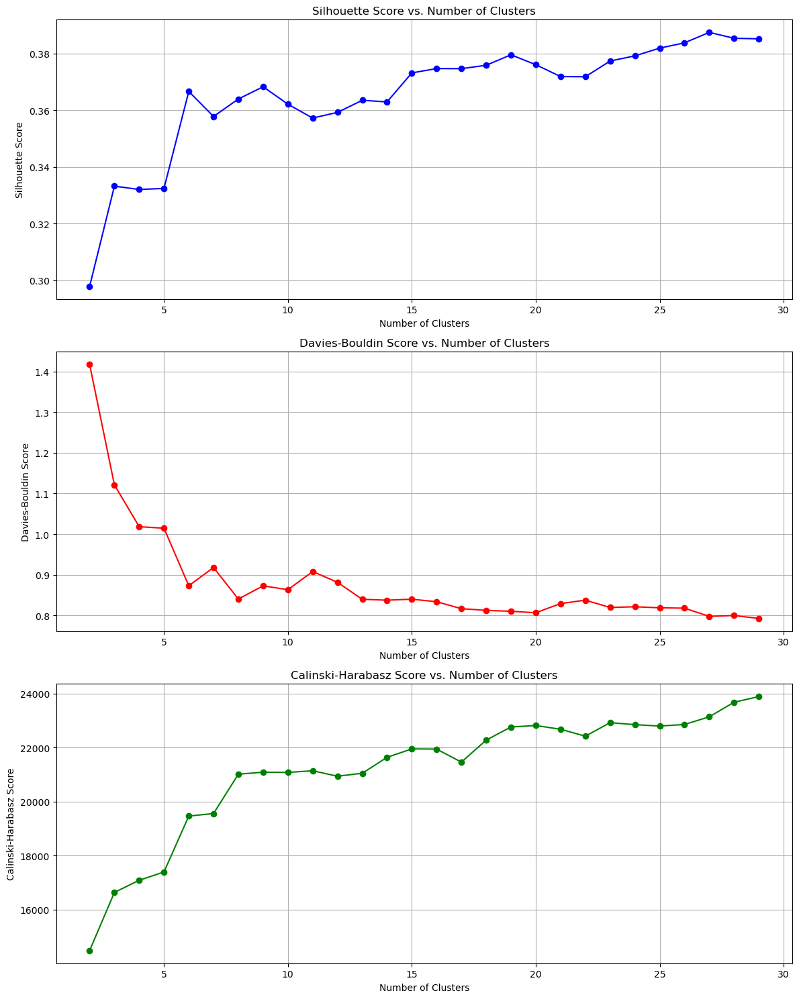

{'silhouette': {'max_score': 0.38744324, 'optimal_clusters': 27},
 'davies_bouldin': {'min_score': 0.7923549111150109, 'optimal_clusters': 29},
 'calinski_harabasz': {'max_score': 23882.245025689866,
  'optimal_clusters': 29}}

In [20]:
evaluate_kmeans_clustering(umap_data)

In [7]:
optimal_clusters = 7

kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(umap_data)

target_series = pd.Series(cluster_labels)

plot_algo3d_interactive(umap_data, target_series, algo_name='UMAP', target_name='Clusters', dot_size=2)


  File "c:\Users\barto\anaconda3\envs\mda\lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


In [19]:
optimal_clusters = 20

kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(umap_data)

target_series = pd.Series(cluster_labels)

plot_algo3d_interactive(umap_data, target_series, algo_name='UMAP', target_name='Clusters', dot_size=2)

  File "c:\Users\barto\anaconda3\envs\mda\lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


In [20]:
umap_data_pd = pd.DataFrame(umap_data, columns=[[f'T-SNE {i}' for i in range(1, 4)]], index=raw_products_without_nulls.index)

umap_data_clusters_pd = pd.concat([umap_data_pd, target_series], axis=1)
umap_data_clusters_pd.columns = ['UMAP 1', 'UMAP 2', 'UMAP 3', 'CLUSTER']
umap_data_clusters_pd

,UMAP 1,UMAP 2,UMAP 3,CLUSTER
0,9.009860,8.577393,-5.335503,8.0
1,7.713243,2.694103,13.221543,3.0
2,9.984249,8.096762,-6.893775,8.0
3,11.007212,11.794331,1.390603,7.0
4,11.216088,8.293610,8.578471,4.0
...,...,...,...,...
32180,NaN,NaN,NaN,5.0
32260,NaN,NaN,NaN,2.0
32291,NaN,NaN,NaN,2.0
32306,NaN,NaN,NaN,19.0


In [21]:
umap_data_pd

,T-SNE 1,T-SNE 2,T-SNE 3
0,9.009860,8.577393,-5.335503
1,7.713243,2.694103,13.221543
2,9.984249,8.096762,-6.893775
3,11.007212,11.794331,1.390603
4,11.216088,8.293610,8.578471
...,...,...,...
32946,0.155179,7.380971,1.823148
32947,3.743042,-3.731985,5.663427
32948,5.305263,-2.729538,8.835469
32949,7.948540,8.124932,9.593429


#### ***UMAP*** with ***KMEANS EDA***

In [47]:
umap_data_cluster_interesting = umap_data_clusters_pd[umap_data_clusters_pd['CLUSTER'] == 9].iloc[:, :-1]
umap_data_cluster_interesting

,UMAP 1,UMAP 2,UMAP 3
6,9.792316,1.917405,3.998345
79,10.207777,3.161244,4.676305
162,9.942006,2.809876,5.632772
287,-3.035083,13.002665,8.456148
297,8.781042,2.873043,6.990473
...,...,...,...
23318,NaN,NaN,NaN
26232,NaN,NaN,NaN
27888,NaN,NaN,NaN
30122,NaN,NaN,NaN


In [48]:
testing_raw_products = raw_products_without_nulls.iloc[umap_data_cluster_interesting.index, :]
testing_raw_products

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
6,732bd381ad09e530fe0a5f457d81becb,cool_stuff,56.0,1272.0,4.0,18350.0,70.0,24.0,44.0
79,07f01b6fcacc1b187a71e5074199db2d,agro_industria_e_comercio,39.0,430.0,1.0,16400.0,63.0,66.0,56.0
166,1cf39a397efa955b102a52ee7ec5531c,automotivo,35.0,907.0,3.0,18200.0,56.0,15.0,15.0
293,f777c903946dd86fd00cd5b32ec3e907,construcao_ferramentas_construcao,57.0,954.0,4.0,21400.0,20.0,20.0,20.0
305,26d114f0b4f14f5e3b3db0e211019777,moveis_decoracao,51.0,582.0,2.0,17400.0,42.0,35.0,42.0
...,...,...,...,...,...,...,...,...,...
23766,59af9f8790e7a3f82851c321f0e825bf,cama_mesa_banho,51.0,454.0,2.0,22525.0,45.0,55.0,65.0
26724,cd1db0c97e4b3644bb52432611e09c58,moveis_decoracao,52.0,583.0,2.0,30000.0,88.0,45.0,41.0
28409,d104587c550fe86cd47e55d8f1b3ca72,utilidades_domesticas,52.0,338.0,3.0,16500.0,60.0,45.0,40.0
30687,ad5e26211dacf07063fac8864fb68e4f,esporte_lazer,54.0,1069.0,3.0,26100.0,80.0,85.0,20.0


In [14]:
testing_raw_products

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
10,14aa47b7fe5c25522b47b4b29c98dcb9,cama_mesa_banho,54.0,630.0,1.0,1100.0,16.0,10.0,16.0
66,bfc1d1c62b1f7f401d8d9dda962bb870,esporte_lazer,50.0,255.0,2.0,950.0,60.0,15.0,15.0
109,67bea89008edcb996cfe4e3d062b62a8,utilidades_domesticas,56.0,414.0,1.0,1200.0,23.0,22.0,16.0
115,8efa775719397f78f79c8e5c7b0afbd4,moveis_decoracao,22.0,275.0,1.0,1000.0,30.0,18.0,18.0
...,...,...,...,...,...,...,...,...,...
32904,5f24a2c5fe04fac8072d899fffa77540,utilidades_domesticas,49.0,678.0,1.0,934.0,28.0,27.0,17.0
32923,7088744b00831b410bd17716cb578f39,informatica_acessorios,51.0,311.0,1.0,1013.0,30.0,15.0,16.0
32925,056b837251897cfc6f46d3643bad614f,ferramentas_jardim,52.0,471.0,4.0,1150.0,17.0,8.0,31.0
32933,6f79d50d852c044e3f7f0954d13aeacf,moveis_decoracao,53.0,194.0,11.0,1100.0,31.0,11.0,26.0


In [49]:
raw_order_items_interesting = raw_order_items[raw_order_items['product_id'].isin(testing_raw_products['product_id'])]
raw_order_reviews_interesting = raw_order_reviews[raw_order_reviews['order_id'].isin(raw_order_items_interesting['order_id'])]
raw_order_reviews_interesting

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
54,94c4db81ff5c234f53b54a15a8a41583,3fb155b4897652f5cdf1b5efff32a465,5,NaN,NaN,2017-12-15 00:00:00,2017-12-17 14:43:35
68,6d06808638ec0701bccd70bc8d462c28,97d2f8fe76f2f253b8291e17b5383884,1,NaN,O produto não chegou no prazo estipulado e cau...,2016-12-09 00:00:00,2016-12-19 14:10:43
76,60c714ed14cef913944a3147094a4742,9ac05114800f02bfaa783bd76842dbe2,1,NaN,"Produto muito inferior, mal acabado.",2018-07-03 00:00:00,2018-07-05 19:03:52
104,352609f0f2d34ce5d3b8de817ee948d5,96b947c986b42f213c9e6b8ccccedb89,3,Não recebi o produto.,NaN,2018-08-25 00:00:00,2018-08-25 20:53:41
206,a60dfbe4f5ccf7fb015fd9e3b33930d1,cd383d7a5f926abfe7b2ee1b80078b45,5,NaN,NaN,2017-02-24 00:00:00,2017-04-01 02:29:39
...,...,...,...,...,...,...,...
98959,837cf5e1290bfadeb05f96783f6bb09f,d9334f59be2037102baca42368082bfb,5,NaN,NaN,2017-07-26 00:00:00,2017-07-27 09:03:58
98982,1176d7810ac5d5aae63cd02b1f358093,dfe94fc0123a2667259503f695edf46e,5,NaN,NaN,2017-10-04 00:00:00,2017-10-06 13:26:59
99032,ffe782f0d3400457f3ca2de30c0ba2f3,e12b22c34034589b6eb958933031f6df,5,NaN,Bom de mais comprar com voce,2017-12-03 00:00:00,2017-12-03 18:44:13
99105,a00038427ff0a7cc00e46913907d67fa,cbaa06517efa6c48a336a917c53e2561,4,Muito bom,Poderia ser excelente se o suporte não tivesse...,2018-05-04 00:00:00,2018-05-04 21:36:44


<Axes: xlabel='review_score', ylabel='count'>

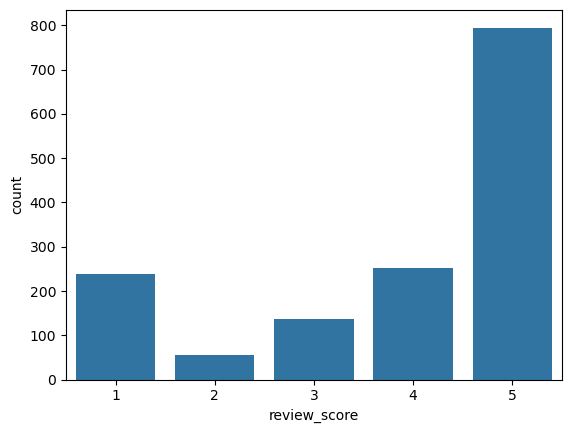

In [50]:
sns.countplot(raw_order_reviews_interesting, x = 'review_score')

### ***UMAP*** with ***Agglomerative CLustering***

The highest silhouette score: 0.3482215404510498 (Optimal clusters: 28)
The lowest Davies-Bouldin score: 0.8282878782007126 (Optimal clusters: 21)
The highest Calinski-Harabasz score: 20465.593423994997 (Optimal clusters: 29)


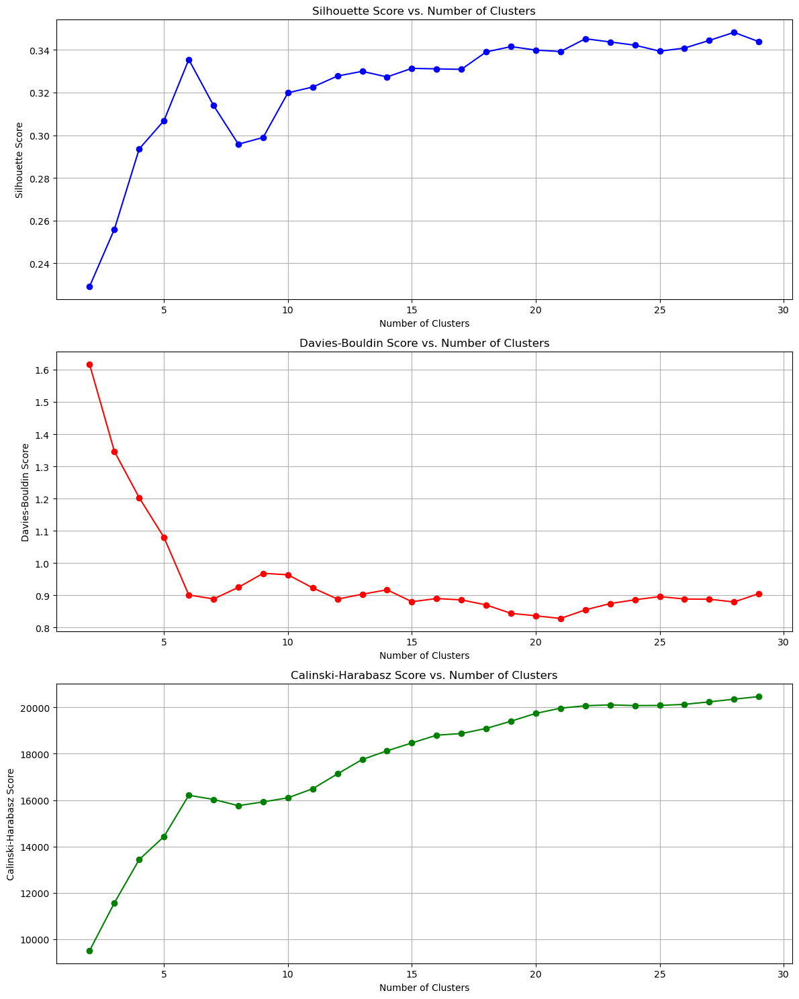

In [40]:
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
import numpy as np

# Initialize lists to store evaluation scores
sil_scores = []
db_scores = []
ch_scores = []

# Define the range of clusters to search
search_range = range(2, 30)

# Iterate through different numbers of clusters
for k in search_range:
    agglo = AgglomerativeClustering(n_clusters=k, metric='euclidean', linkage='ward')
    labels = agglo.fit_predict(umap_data)
    
    # Calculate scores
    sil_scores.append(silhouette_score(umap_data, labels))
    db_scores.append(davies_bouldin_score(umap_data, labels))
    ch_scores.append(calinski_harabasz_score(umap_data, labels))

# Find optimal clusters for each metric
max_sil_score = max(sil_scores)
optimal_clusters_sil = search_range[np.argmax(sil_scores)]

min_db_score = min(db_scores)
optimal_clusters_db = search_range[np.argmin(db_scores)]

max_ch_score = max(ch_scores)
optimal_clusters_ch = search_range[np.argmax(ch_scores)]

print(f"The highest silhouette score: {max_sil_score} (Optimal clusters: {optimal_clusters_sil})")
print(f"The lowest Davies-Bouldin score: {min_db_score} (Optimal clusters: {optimal_clusters_db})")
print(f"The highest Calinski-Harabasz score: {max_ch_score} (Optimal clusters: {optimal_clusters_ch})")

# Plot the scores
plt.figure(figsize=(12, 15))

# Subplot for Silhouette Score
plt.subplot(3, 1, 1)
plt.plot(search_range, sil_scores, marker='o', linestyle='-', color='b')
plt.title('Silhouette Score vs. Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.grid(True)

# Subplot for Davies-Bouldin Score
plt.subplot(3, 1, 2)
plt.plot(search_range, db_scores, marker='o', linestyle='-', color='r')
plt.title('Davies-Bouldin Score vs. Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Davies-Bouldin Score')
plt.grid(True)

# Subplot for Calinski-Harabasz Score
plt.subplot(3, 1, 3)
plt.plot(search_range, ch_scores, marker='o', linestyle='-', color='g')
plt.title('Calinski-Harabasz Score vs. Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Calinski-Harabasz Score')
plt.grid(True)

plt.tight_layout()
plt.show()


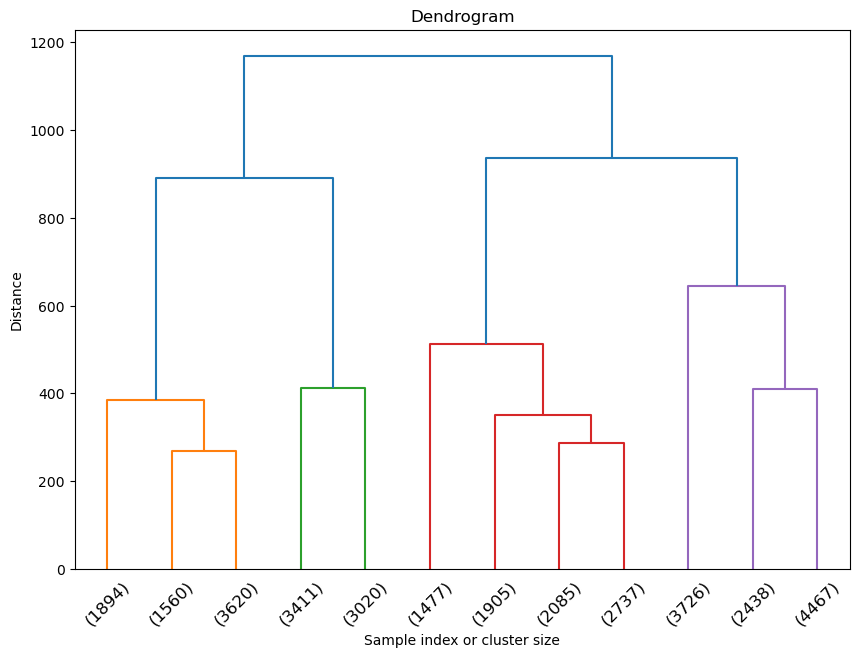

In [14]:
agglo = AgglomerativeClustering(n_clusters=6, metric='euclidean', linkage='ward')
agglo_clusters = agglo.fit_predict(umap_data)

# Plot clusters
agglo_target = pd.Series(agglo_clusters)

plot_algo3d_interactive(umap_data, agglo_target, 'Agglomerative Clustering', 'Clusters')

# Generate and plot dendrogram (requires SciPy linkage)
linked = linkage(umap_data, method='ward')
plt.figure(figsize=(10, 7))
dendrogram(linked, truncate_mode='lastp', p=12, leaf_rotation=45., leaf_font_size=12.)
plt.title("Dendrogram")
plt.xlabel("Sample index or cluster size")
plt.ylabel("Distance")
plt.show()

---
# ***Quality of products***
---

In [37]:
raw_order_reviews_1_star = raw_order_reviews[raw_order_reviews['review_score'] == 1]
raw_order_items_1_star = raw_order_items[raw_order_items['order_id'].isin(raw_order_reviews_1_star['order_id'])]
raw_product_1_star = raw_products_without_nulls[raw_products_without_nulls['product_id'].isin(raw_order_items_1_star['product_id'])]
raw_product_1_star

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_labels
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0,9
7,2548af3e6e77a690cf3eb6368e9ab61e,moveis_decoracao,56.0,184.0,2.0,900.0,40.0,8.0,40.0,54
8,37cc742be07708b53a98702e77a21a02,eletrodomesticos,57.0,163.0,1.0,400.0,27.0,13.0,17.0,28
20,1c1890ba1779090cd54008a3c3302921,moveis_decoracao,27.0,158.0,4.0,2550.0,29.0,24.0,45.0,54
26,f6574524b07d5bb753bab6f35abe2d06,malas_acessorios,52.0,573.0,5.0,3600.0,35.0,25.0,50.0,50
...,...,...,...,...,...,...,...,...,...,...
32931,9ce4603565c839785b24a7e95e28f4eb,cool_stuff,40.0,1516.0,2.0,800.0,22.0,15.0,27.0,26
32934,1060d9ab6b911bfce1439c25afcd790b,informatica_acessorios,39.0,1257.0,1.0,130.0,16.0,13.0,13.0,44
32940,dfec64aac9b864b2807a7be33222b75f,cama_mesa_banho,58.0,252.0,4.0,850.0,38.0,7.0,28.0,13
32942,16280ca280a86fee2ba3c928ed04439f,moveis_decoracao,64.0,236.0,11.0,2200.0,31.0,11.0,26.0,54


In [38]:
# Find the intersection of indices in umap_data_pd and raw_product_1_star
valid_indices = umap_data_pd.index.intersection(raw_product_1_star.index)

# Select rows from umap_data_pd and target_series based on valid indices
umap_data_1_star = umap_data_pd.loc[valid_indices, :].to_numpy()
target_series = target_series.reindex(umap_data_pd.index)
target_series_1_star = target_series.loc[valid_indices]

# Plot the data
plot_algo3d_interactive(umap_data_1_star, pd.Series(np.ones((len(raw_product_1_star.index)))), algo_name='UMAP', target_name='Clusters', dot_size=2)


We literally can't classify using people opinion.

## *Maybe product name works*

In [26]:
raw_products_without_nulls['product_labels'] = raw_products_without_nulls['product_category_name'].astype('category').cat.codes
raw_products_without_nulls

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_labels
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0,62
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0,3
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0,32
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0,9
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0,72
...,...,...,...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,45.0,67.0,2.0,12300.0,40.0,40.0,40.0,54
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,41.0,971.0,1.0,1700.0,16.0,19.0,16.0,23
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,50.0,799.0,1.0,1400.0,27.0,7.0,27.0,13
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,60.0,156.0,2.0,700.0,31.0,13.0,20.0,44


In [28]:
plot_algo3d_interactive(umap_data, raw_products_without_nulls['product_labels'], 'something', 'something', dot_size=2)

No they do not

---
# ***Deliveries***
---

In [6]:
geolocation_data = pd.read_csv(r'attachments_p2/geolocation_dataset.csv')
sellers_data = pd.read_csv(r'attachments_p2/sellers_dataset.csv')

In [7]:
reviews_orders = raw_order_reviews[['order_id', 'review_score']]
raw_order_items_reviews = raw_order_items[raw_order_items['order_id'].isin(reviews_orders['order_id'])]
seller_order_review = pd.merge(raw_order_items_reviews[['order_id', 'seller_id']], reviews_orders, on='order_id', how='left')

seller_with_valid_reviews = sellers_data[sellers_data['seller_id'].isin(seller_order_review['seller_id'])]
seller_with_valid_reviews.rename(columns={'seller_zip_code_prefix': 'geolocation_zip_code_prefix'}, inplace=True)
seller_reviews = pd.merge(seller_with_valid_reviews, seller_order_review, on='seller_id', how='left')

geo_reviews = pd.merge(geolocation_data, seller_reviews[['seller_id', 'review_score', 'geolocation_zip_code_prefix']], on='geolocation_zip_code_prefix', how='left')
geo_reviews = geo_reviews.dropna()

In [12]:
geo_reviews

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,seller_id,review_score,Group_Avg
3,1041,-23.544392,-46.639499,sao paulo,SP,e5cbe890e679490127e9a390b46bbd20,5.0,4.500000
4,1041,-23.544392,-46.639499,sao paulo,SP,e5cbe890e679490127e9a390b46bbd20,4.0,4.500000
5,1035,-23.541578,-46.641607,sao paulo,SP,1d503743d2526f03f0c2c89540ee008c,1.0,4.235294
6,1035,-23.541578,-46.641607,sao paulo,SP,1d503743d2526f03f0c2c89540ee008c,4.0,4.235294
7,1035,-23.541578,-46.641607,sao paulo,SP,1d503743d2526f03f0c2c89540ee008c,5.0,4.235294
...,...,...,...,...,...,...,...,...
16965871,99730,-27.729373,-52.537491,jacutinga,RS,d1c7fa84e48cfa21a0e595167c1c500e,5.0,4.333333
16965879,99700,-27.641601,-52.272983,erechim,RS,968ee78631915a63fef426d6733d7422,2.0,3.000000
16965880,99700,-27.641601,-52.272983,erechim,RS,968ee78631915a63fef426d6733d7422,4.0,3.000000
16965882,99700,-27.635255,-52.271352,erechim,RS,968ee78631915a63fef426d6733d7422,2.0,3.000000


In [16]:
# Group by 'Group' column and calculate the mean of 'Value'
geo_reviews['Group_Avg'] = geo_reviews.groupby('geolocation_zip_code_prefix')['review_score'].transform('mean')

# Group by 'Group' and aggregate
result = geo_reviews.groupby('geolocation_zip_code_prefix', as_index=False).first()

result


,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state,seller_id,review_score,Group_Avg
0,1001,-23.549292,-46.633559,sao paulo,SP,8602a61d680a10a82cceeeda0d99ea3d,5.0,4.473684
1,1021,-23.545168,-46.632249,sao paulo,SP,e0487761face83d64fcada2408959a36,4.0,3.846154
2,1022,-23.544987,-46.633454,sao paulo,SP,09bad886111255c5b5030314fc7f1a4a,5.0,5.000000
3,1023,-23.542603,-46.630943,sao paulo,SP,f049a72cf58fd31b11f8919cade515e7,4.0,3.800000
4,1026,-23.539495,-46.632844,são paulo,SP,c1dde11f12d05c478f5de2d7319ad3b2,1.0,3.593333
...,...,...,...,...,...,...,...,...
2233,99300,-28.831260,-52.510733,soledade,RS,f524ad65d7e0f1daab730ef2d2e86196,1.0,1.000000
2234,99500,-28.289446,-52.794123,carazinho,RS,4bde6149c15cf7e177b36fa060dd6de8,5.0,4.263158
2235,99670,-27.783656,-52.807832,ronda alta,RS,4fae87d32467e18eb46e4a76a0a0b9ce,5.0,5.000000
2236,99700,-27.634768,-52.280294,erechim,RS,968ee78631915a63fef426d6733d7422,2.0,3.000000


<Axes: xlabel='geolocation_lat', ylabel='geolocation_lng'>

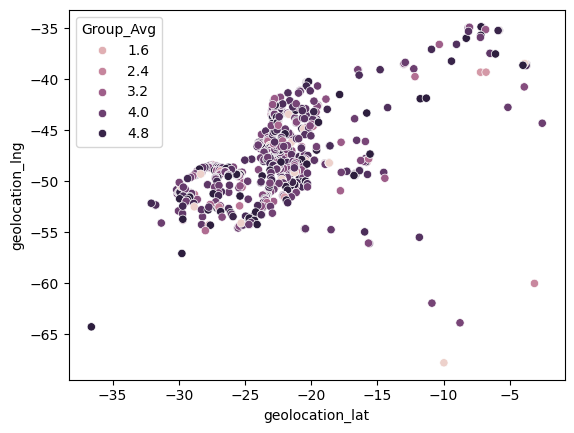

In [17]:
sns.scatterplot(data=result, x = result['geolocation_lat'], y = result['geolocation_lng'], hue=result['Group_Avg'])

There is no correlation between location and review score